<a href="https://colab.research.google.com/github/jocelynbaduria/cmpe-257_Machine_Learning/blob/main/Jocelyn_Baduria_257_Midterm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### 1. Business case and value-- what hypotheses are you trying to prove? 
*   Predict the estimated average selling price in the market using given data.






Story to tell to the Buyer:

Based on the data analysis of Zillow housing prices there is a double increase of listing prices based on the yearly distribution from year 2020 to 2021. Also, the prediction of house prices is increasing based on the predicted data compared with the actual listing prices.

In conclusion, investment in housing property is a solid assets. Every year the house prices increases and so there is a profit on house investment. 

Similary, some people invest in housing property because of the house price and rent increase every year. Why not rent if you have money some may call it rent to own property. It is like you are saving for your own investment.


Questions to answer in your narrative

1. What is the golden cluster? # Bhuvana/Jocelyn

Data Narrative : 

Golden Cluster shows a variety of listing type of houses. If I have a client, I will ask what is the budget of the houses they are looking for. 

These are the range of the house listing with range of prices.

Lowest Price : House For Sale (250k ~ 2.8M)

Second Price : MultiFamily Home For Sale (150k ~ 1.75M)

Third Price : Condo (100k ~ 2.6M)

Fourth Price : Home For Sale (50k ~ 550k)

Fifth Price : Foreclosure (645k ~ 1.7M)

Where should an investor  invest? What houses would you recommend they buy as an investment property? 

If investor is single he/she can take a condo unit for a house price of 100k. If the investors have family there are three choices the lowest ( Home For Sale ), (MultiFamily Home For Sale), (House for Sale). 
If the investors are realty investors he/she can check the Foreclosure houses.


Find the golden cluster for investment : lowest cost house that has the greatest probability of price increase in the next few years.

All the listing type of houses were directly proportional to the house price and rent increase. It means investment on realty is always a profit gain. 

The lower the cost you bought it the more profit you get.


2. Predict the estimated average selling price in the market using given data # Jocelyn

Data Narrative :

a.Based on the interactive prediction chart (refer. 2.3.3) There is an increase of selling price based on the prediction trend.

[Price vs Zillow Price Estimate](https://colab.research.google.com/drive/1HH_7f7Yeh94hVTwLpgXklHpBeMq6a6oe#scrollTo=Pfe5qB3Y156p&line=2&uniqifier=1)


b. Based on the latent variable date, sale and list price. There is an increase of predition of selling price per year (refer 4.1.1 Distribution of amalgamated data and 6.1.1 Prediction Latent Variable Date, Listed and Sale Price)


c.Also, based on the prediction trend houses ranging from 3~4M have a current Zillow rent trend estimate. The higher the price the lower the rent Zillow estimate.

3. Data Visualization # Bhuvana, Weifeng, Jocelyn
Data Narrative :

Market Trends:

Based on interactive plot(refer 2.3.1) Price vs High Price Listing Type.

a.High : There are variety of houses for sale ranging from 200k to 17M.
       There are some houses foreclosure properties between 600k to 5M.
         
b.Medium : There are 100k to 2.8M for Multifamily home for sale 

c.Low: There are a variety lower price for all the listed listing.

Interested Buyers:

a.Most buyer interested houses : Data shows that most buyer Under Contract  listing are interested with 3bedrooms and 2bathrooms with price range (400~ 500k).(refer 2.3.1 and 2.3.2)


b.Average buyer interested houses : Average buyer interested in house prices 658k. (refer 2.3.1, Average Price vs Listing Type - Under Contract )


c.Less buyer interested houses: There are no buyer in the price range between 3.4M to 16M. (refer 2.3.2)


4. Scrape the location related information / latent variables [choose 2 out of 5 factors/latent variables] # Weifeng/Jocelyn/Bhuvana

Data Narrative : 

I downloaded the file from Zillow website to use for my amalgation of dataset comparison with year comparison. Using scatter mapbox I can see the neighborhood of location. The data provided is located around near in San Jose, San Diego and Denver. San Diego is famous in restaurants waterfront based on my own domain knowledge so most of the houses located there are near in restaurants. For other location need to find the list of restaurants and compare the house listed using cosine similarity but it will take time to scrape and study the location.

5. If you buy a house today how much will the price change ( profit or loss, increase or decrease) after 2 years of your purchase?

Based on the data analysis of Zillow housing prices there is a double increase of listing prices based on the yearly distribution from year 2020 to 2021. Also, the prediction of house prices is increasing based on the predicted data compared with the actual listing prices.

In conlusion, investment in housing property is a solid assets. Every year the house prices increased, and so there is a profit on house investment. 

Similary, some people invest in housing property because of the house price and rent increase every year. Why not rent if you have money and some may call it "rent to own property". It is like you are saving money for your own investment.

### 2. Data Preparation using first data enrichment (add dataset to base data set) # Bhuvana, Weifeng, Jocelyn

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


###2.1 Import all the libraries, note always run after restarting the colab

In [22]:
import glob
import os
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import style
import plotly.figure_factory as ff
import itertools

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LinearRegression
# For Feature Importance
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import permutation_importance
from sklearn.decomposition import PCA

# For KMeans 
from sklearn.cluster import KMeans
from sklearn import metrics

# For Muller Loop Regression
import time
from sklearn import metrics
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor
# For Muller Classification
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.neural_network import MLPClassifier

### 2.2 Data Cleaning

I used shorcut for my Drive folder for Underdog and data for easy access.

Use this path if you want to run my notebook 1st shorcut, 2nd shortcut. The full path doesn't work for me if i run it.

##### Load the dataset, Cleaning and Wrangling # Jocelyn, Bhuvana


In [159]:
# 1st Shorcut
path = '/content/drive/My Drive/data/Original_data'
realestate_data = pd.concat(map(pd.read_csv, glob.glob(os.path.join(path, '*.csv'))), ignore_index=True)

# 2nd Shorcut
# path = '/content/drive/My Drive/Underdog/midterm_exam/data/Original_data'
# realestate_data = pd.concat(map(pd.read_csv, glob.glob(os.path.join(path, '*.csv'))), ignore_index=True)

# The full path doesn't work for me maybe the MLSpring-2021 has shorcut too.
# path = '/content/drive/My Drive/Colab Notebooks/MLSpring-2021/teams/Underdog/midterm_exam/data/Original_data'
# realestate_data = pd.concat(map(pd.read_csv, glob.glob(os.path.join(path, '*.csv'))), ignore_index=True)

In [ ]:
# realestate_data_tmp = []
# for i in range(1, 6):
#   realestate_data = pd.read_csv('/content/drive/My Drive/data/properties_2021_03_{}.csv'.format(i), index_col=0)
#   realestate_data_tmp.append(realestate_data)
# realestatedata = pd.concat(realestate_data_tmp)

In [ ]:
from google.colab import data_table
data_table.DataTable(realestate_data)

,rank,property_id,address,latitude,longitude,price,currency,bathrooms,bedrooms,area,land_area,zestimate,rent_zestimate,days_on_zillow,sold_date,is_zillow_owned,image,listing_type,broker_name,input,property_url,listing_url
0,441,19641890,"7100 Rainbow Dr APT 34, San Jose, CA 95129",37.299863,-122.028287,840000.0,USD,2.0,2.0,1050.0 sqft,NaN,872126.0,2650.0,31,NaN,False,https://photos.zillowstatic.com/fp/906dfc88c87...,Condo for sale,NaN,"https://www.zillow.com/homes/san-jose,-CA_rb/",https://www.zillow.com/homedetails/7100-Rainbo...,"https://www.zillow.com/homes/san-jose,-CA_rb/1..."
1,42,17137939,"6121 Parkside Ave, San Diego, CA 92139",32.665719,-117.054594,619000.0,USD,3.0,4.0,1844.0 sqft,NaN,640674.0,3100.0,1,NaN,False,https://photos.zillowstatic.com/fp/316da0f2c56...,House for sale,RE/MAX Clarity,"https://www.zillow.com/homes/San-Diego,-CA_rb/",https://www.zillow.com/homedetails/6121-Parksi...,"https://www.zillow.com/homes/San-Diego,-CA_rb/..."
2,773,13421124,"9234 E Lehigh Ave, Denver, CO 80237",39.646839,-104.882522,339900.0,USD,3.0,3.0,1408.0 sqft,NaN,348728.0,2100.0,22,NaN,False,https://photos.zillowstatic.com/fp/49edd313f7e...,Under Contract,Blackwell Real Estate LLC,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/homedetails/9234-E-Lehi...,"https://www.zillow.com/homes/denver,-co_rb/20_p/"
3,423,63786672,"925 N Lincoln St UNIT 12J-S, Denver, CO 80203",39.730828,-104.986652,340000.0,USD,1.0,1.0,769.0 sqft,NaN,340001.0,1565.0,10,NaN,False,https://photos.zillowstatic.com/fp/6bef7c2ea2b...,Under Contract,8z Real Estate,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/homedetails/925-N-Linco...,"https://www.zillow.com/homes/denver,-co_rb/11_p/"
4,648,251843303,"4345 N Elizabeth St, Denver, CO 80216",39.777014,-104.956594,250000.0,USD,2.0,3.0,1223.0 sqft,NaN,286430.0,2800.0,16,NaN,False,https://photos.zillowstatic.com/fp/67c57116537...,Multi-family home for sale,HomeSmart,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/homedetails/4345-N-Eliz...,"https://www.zillow.com/homes/denver,-co_rb/17_p/"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12206,66,2072894286,"65 Skyline Dr LOT 1, San Diego, CA 92114",32.701755,-117.055096,220000.0,USD,NaN,NaN,NaN,1 acres,NaN,NaN,1,NaN,False,https://photos.zillowstatic.com/fp/08fa69a61f0...,Lot / Land for sale,NaN,"https://www.zillow.com/homes/San-Diego,-CA_rb/",https://www.zillow.com/homedetails/65-Skyline-...,"https://www.zillow.com/homes/San-Diego,-CA_rb/..."
12207,263,54769625,"5145 Archangel Dr, Alviso, CA 95134",37.425330,-121.971273,1288800.0,USD,3.0,3.0,1981.0 sqft,NaN,1365875.0,3800.0,9,NaN,False,https://photos.zillowstatic.com/fp/91a1db18058...,House for sale,NaN,"https://www.zillow.com/homes/san-jose,-CA_rb/",https://www.zillow.com/homedetails/5145-Archan...,"https://www.zillow.com/homes/san-jose,-CA_rb/7_p/"
12208,363,2080124181,"Residence 2 Plan, DEL SUR : Avante",33.018400,-117.126000,774900.0,USD,3.0,3.0,1688.0 sqft,NaN,NaN,NaN,5,NaN,False,https://photos.zillowstatic.com/fp/d3788944a12...,New construction,NaN,"https://www.zillow.com/homes/San-Diego,-CA_rb/",https://www.zillow.com/community/del-sur-avant...,"https://www.zillow.com/homes/San-Diego,-CA_rb/..."
12209,29,16660087,"Pirineos Way, Carlsbad, CA 92009",33.087663,-117.251486,489999.0,USD,2.0,2.0,1400.0 sqft,NaN,498235.0,2800.0,4,NaN,False,https://photos.zillowstatic.com/fp/05f19f59b66...,Coming soon,Ardent Real Estate Services,"https://www.zillow.com/homes/carlsbad,-CA_rb/",https://www.zillow.com/homedetails/2607-Pirine...,"https://www.zillow.com/homes/carlsbad,-CA_rb/"


In [ ]:
realestate_data.shape

(12211, 22)

In [ ]:
# Reset index date per year for Plotting
# realestate_data.reset_index(level=0, inplace=True)

In [ ]:
realestate_data.describe()

,rank,property_id,latitude,longitude,price,bathrooms,bedrooms,zestimate,rent_zestimate,days_on_zillow,sold_date
count,12211.000000,1.221100e+04,12156.000000,12156.000000,1.219900e+04,11072.000000,11133.000000,9.456000e+03,9237.000000,12211.000000,0.0
mean,316.393989,5.227264e+08,35.596172,-114.901354,1.130022e+06,2.564848,2.934250,1.089447e+06,3565.777742,29.052657,NaN
std,232.577190,8.575637e+08,2.993914,6.217846,1.956728e+06,1.264191,1.317052,1.242797e+06,3109.056421,77.173482,NaN
min,1.000000,1.304501e+07,32.545903,-122.030747,0.000000e+00,1.000000,0.000000,5.584600e+04,975.000000,0.000000,NaN
25%,104.000000,1.685606e+07,32.839820,-117.294760,4.500000e+05,2.000000,2.000000,4.782792e+05,2295.000000,3.000000,NaN
50%,274.000000,5.477087e+07,33.159129,-117.142779,7.300000e+05,2.000000,3.000000,7.553405e+05,2850.000000,9.000000,NaN
75%,509.000000,2.953509e+08,39.655862,-105.047445,1.225000e+06,3.000000,4.000000,1.285021e+06,3600.000000,19.000000,NaN
max,800.000000,2.146957e+09,39.813670,-104.737220,4.900000e+07,12.000000,19.000000,1.627986e+07,55000.000000,1002.000000,NaN


In [ ]:
realestate_data.isnull().sum()/realestate_data.shape[0] * 100

rank                 0.000000
property_id          0.000000
address              0.000000
latitude             0.450414
longitude            0.450414
price                0.098272
currency             0.000000
bathrooms            9.327655
bedrooms             8.828106
area                 8.312178
land_area           94.103677
zestimate           22.561625
rent_zestimate      24.355090
days_on_zillow       0.000000
sold_date          100.000000
is_zillow_owned      0.000000
image                0.000000
listing_type         0.000000
broker_name         28.621735
input                0.000000
property_url         0.000000
listing_url          0.000000
dtype: float64

In [ ]:
realestate_data.shape

(12211, 22)

##### Drop Columns, rows with missing values

In [ ]:
# Columns
realestate_data = realestate_data.drop(columns=['sold_date', 'land_area', 'currency','is_zillow_owned'])

In [ ]:
realestate_data.shape

(12211, 18)

In [ ]:
# Rows
realestate_data = realestate_data.dropna(subset=['latitude','longitude','price','bathrooms','bedrooms','area','zestimate','rent_zestimate','broker_name'] )

In [ ]:
realestate_data.isnull().sum()/realestate_data.shape[0] * 100

rank              0.0
property_id       0.0
address           0.0
latitude          0.0
longitude         0.0
price             0.0
bathrooms         0.0
bedrooms          0.0
area              0.0
zestimate         0.0
rent_zestimate    0.0
days_on_zillow    0.0
image             0.0
listing_type      0.0
broker_name       0.0
input             0.0
property_url      0.0
listing_url       0.0
dtype: float64

In [ ]:
realestate_data.shape

(6553, 18)

In [ ]:
# Save cleaned data
path = '/content/drive/My Drive/data/Data_created/house_cleaned_data.csv'

realestate_data.to_csv(path, index=False)

Check data types

In [ ]:
realestate_data.dtypes

rank                int64
property_id         int64
address            object
latitude          float64
longitude         float64
price             float64
bathrooms         float64
bedrooms          float64
area               object
zestimate         float64
rent_zestimate    float64
days_on_zillow      int64
image              object
listing_type       object
broker_name        object
input              object
property_url       object
listing_url        object
dtype: object

### 2.3 Interactive Visualization # Jocelyn


Data Narrative:
*   Correlation : With higher correlation

    price and zestimate 

    longitude and latitude

    bathrooms and bedroom

*   Visualization: 

    Most Buyer interested in house for sale with a ranging price of 400k ~ 500k based on data.

    Location per rank vs house prices, shows the prices varies per location.

    There are less buyer interested  around San Diego location, Denver have a higher under contract houses ( Buyer and Seller Agreed to Sale )


In [43]:
# If restarted always run the Import Libraries and authenticate using your google drive account
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/house_cleaned_data.csv'

re_data = pd.read_csv(path)

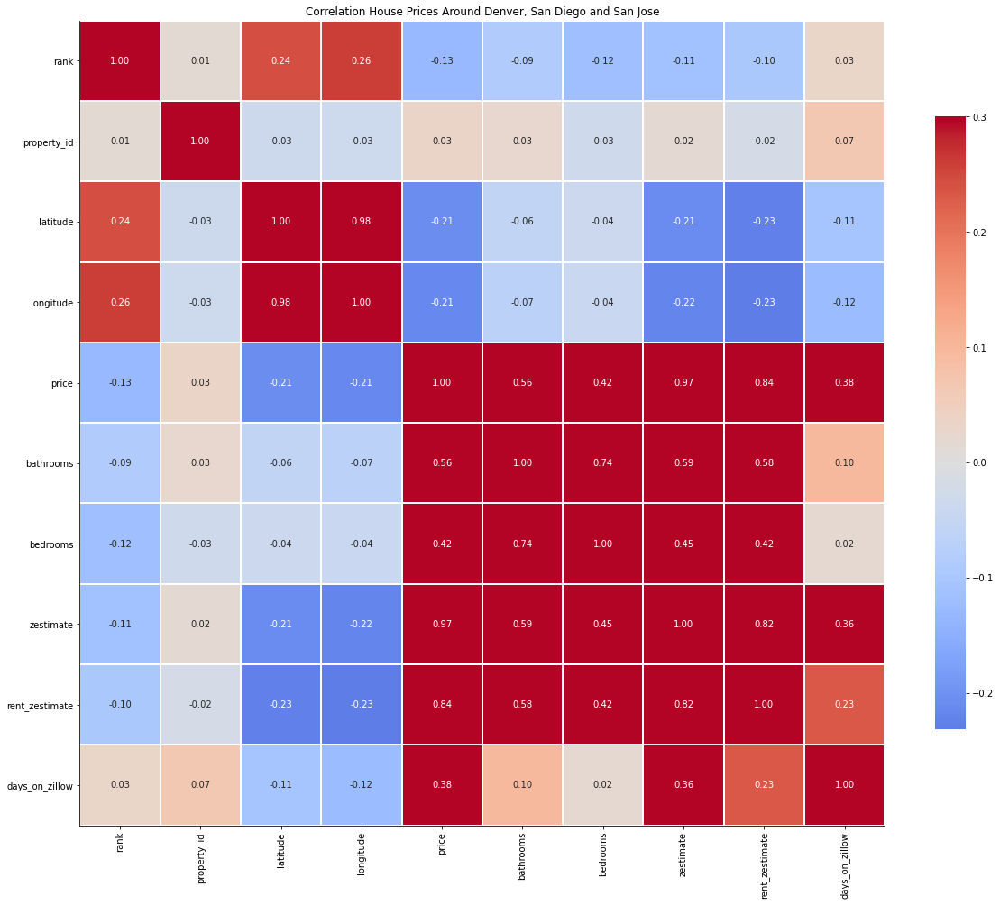

In [ ]:
corr = re_data.corr()
g = sns.heatmap(corr,  vmax=.3, center=0,square=True, linewidths=1, cbar_kws={"shrink": 0.5}, annot=True, fmt='.2f', cmap='coolwarm')
sns.despine()
g.figure.set_size_inches(20,25)
plt.title('Correlation House Prices Around Denver, San Diego and San Jose')
plt.show()

In [ ]:
# Scatter plot comparison of price, rent_zestimate, zestimate per listing type
import plotly.express as px
fig = px.scatter_matrix(re_data, dimensions=["area","price", "rent_zestimate", "zestimate", "longitude", "latitude"], color="listing_type")
fig.show()

In [ ]:
# Location per rank vs price, shows the prices varies per location.
import plotly.express as px
fig = px.scatter_mapbox(re_data, lat="latitude", lon="longitude", color="rank", size="price",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=5,
                  mapbox_style="carto-positron")
fig.show()

In [ ]:
# Location per listing_type vs price
## More houses are for sale around San Diego while around in Denver there are more under contract houses.
import plotly.express as px
fig = px.scatter_mapbox(re_data, lat="latitude", lon="longitude", color="listing_type", size="price",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=5,
                  mapbox_style="carto-positron")
fig.show()

### 2.3.1 Data Distribution Original Data # Jocelyn

In [50]:
# Price vs Zillow Estimate Price ( 400 ~ 500k )
import plotly.express as px
fig = px.histogram(re_data, x="price", y="listing_type", color="listing_type", title="Price vs High Price Listing Type")
fig.show()

In [51]:
# Price vs Zillow Estimate Price ( 500 ~ 600k )
import plotly.express as px
fig = px.histogram(re_data, x="listing_type", y="price", histfunc='avg',color="listing_type", title="Average Price vs Listing Type")
fig.show()

In [46]:
# Price vs Zillow Rent Estimate Price 
import plotly.express as px
fig = px.histogram(re_data, x="rent_zestimate", y="price", color="listing_type",histfunc='avg',title="Price vs Rent Estimate")
fig.show()

In [5]:
# If restarted always run the Import Libraries and authenticate using your google drive account
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/house_cleaned_data.csv'

re_data = pd.read_csv(path)

In [6]:
re_data.head(2)

,rank,property_id,address,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,image,listing_type,broker_name,input,property_url,listing_url
0,42,17137939,"6121 Parkside Ave, San Diego, CA 92139",32.665719,-117.054594,619000.0,3.0,4.0,1844.0 sqft,640674.0,3100.0,1,https://photos.zillowstatic.com/fp/316da0f2c56...,House for sale,RE/MAX Clarity,"https://www.zillow.com/homes/San-Diego,-CA_rb/",https://www.zillow.com/homedetails/6121-Parksi...,"https://www.zillow.com/homes/San-Diego,-CA_rb/..."
1,773,13421124,"9234 E Lehigh Ave, Denver, CO 80237",39.646839,-104.882522,339900.0,3.0,3.0,1408.0 sqft,348728.0,2100.0,22,https://photos.zillowstatic.com/fp/49edd313f7e...,Under Contract,Blackwell Real Estate LLC,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/homedetails/9234-E-Lehi...,"https://www.zillow.com/homes/denver,-co_rb/20_p/"


In [7]:
# X = re_data.iloc[:, [5]].values
x1 = re_data.iloc[:, [5]] # price
x2 = re_data.iloc[:, [10]] # rent_estimate

### 2.3.2 Price vs Average Zillow Rent Estimate per Listing

In [9]:
import plotly.express as px
fig = px.histogram(re_data, x="price", y="rent_zestimate", color="listing_type", histfunc='avg',hover_data=re_data.columns, title='Price vs Average Zillow Rent Estimate')
fig.show()

In [15]:
import plotly.express as px
fig = px.histogram(re_data, x="bedrooms", y="bathrooms", color="listing_type",hover_data=re_data.columns, title='Bathrooms vs Bedrooms')
fig.show()

In [13]:
import plotly.express as px
fig = px.histogram(re_data, x="bathrooms", y="bedrooms", color="listing_type",hover_data=re_data.columns, title='Bathrooms vs Bedrooms')
fig.show()

In [ ]:
import plotly.express as px
fig = px.scatter(re_data, x="listing_type", y="price", color="zestimate", hover_data=re_data.columns, title='Price vs Listing Type')
fig.show()

### 2.3.3 Interactive Prediction Based on Price , Listing Type and Rent Estimates # Jocelyn


In [ ]:
# Price vs Rent Zillow Estimate Price ( 400k ~ 500k )
import plotly.express as px
fig = px.scatter(re_data, x="price", y="rent_zestimate", trendline='ols',  title='Price vs Zillow Rent Estimate Prediction')
fig.show()

In [ ]:
# Price vs Zillow Estimate Price based on listing type
import plotly.express as px
fig = px.scatter(re_data, x="zestimate", y="price", color="listing_type", hover_data=re_data.columns, trendline='lowess', title='Price vs Zillow Price Estimate' )
fig.show()

/usr/local/lib/python3.7/dist-packages/statsmodels/nonparametric/smoothers_lowess.py:165: RuntimeWarning:

invalid value encountered in true_divide



### 3. Feature transformation # # Jocelyn, Bhuvana 
1.	transform features, add new features to dataset via amalgamations (see below) , compare results with original
2.	data distribution
3. Include dimension reduction via: PCA 




### 3.1 Feature importance; gini score # Jocelyn


Data Narrative: 

Using Random Forest Regressor Gini importance (or mean decrease impurity), the highest feature for real estate dataset is property_id.

Similarly using PCA it is also the important feature with a value of (9.9.99999986e-01).


In [20]:
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/house_cleaned_data.csv'

re_data = pd.read_csv(path)

In [21]:
re_data.isnull().sum()/re_data.shape[0] * 100

rank              0.0
property_id       0.0
address           0.0
latitude          0.0
longitude         0.0
price             0.0
bathrooms         0.0
bedrooms          0.0
area              0.0
zestimate         0.0
rent_zestimate    0.0
days_on_zillow    0.0
image             0.0
listing_type      0.0
broker_name       0.0
input             0.0
property_url      0.0
listing_url       0.0
dtype: float64

Feature transfomation1 : Convert datatypes to Categorical values for Feature importance analysis

In [22]:
re_data['address'] = re_data['address'].astype('category').cat.codes
re_data['area'] = re_data['area'].astype('category').cat.codes
re_data['listing_type'] = re_data['listing_type'].astype('category').cat.codes
re_data['broker_name'] = re_data['broker_name'].astype('category').cat.codes
re_data['input'] = re_data['input'].astype('category').cat.codes
re_data['image'] = re_data['image'].astype('category').cat.codes
re_data['property_url'] = re_data['property_url'].astype('category').cat.codes
re_data['listing_url'] = re_data['listing_url'].astype('category').cat.codes

In [23]:
# Load the data set and split for training and testing.
column_name=['rank','property_id','address','latitude','longitude','price','bathrooms','bedrooms','area','zestimate',
             'rent_zestimate','days_on_zillow','image','listing_type','broker_name','input','property_url','listing_url']
X = pd.DataFrame(re_data, columns=column_name) 
y = pd.DataFrame(re_data, columns=column_name)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=12)

In [24]:
# Fit the Random Forest Regressor with 100 Decision Trees:
rf = RandomForestRegressor(n_estimators=100)
rf.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [25]:
# To get the feature importances from the Random Forest model use the feature_importances_ argument:
rf.feature_importances_

array([2.70981515e-07, 9.99936702e-01, 1.73684061e-07, 8.11384502e-06,
       9.70121261e-06, 3.12243651e-05, 5.09893966e-07, 5.18154691e-07,
       3.01508584e-07, 6.18890603e-06, 1.74206240e-06, 1.91274660e-07,
       6.94221800e-07, 1.09817778e-07, 1.22896168e-07, 1.66565577e-06,
       1.51331031e-07, 1.61843515e-06])

Text(0.5, 0, 'Random Forest Feature Importance')

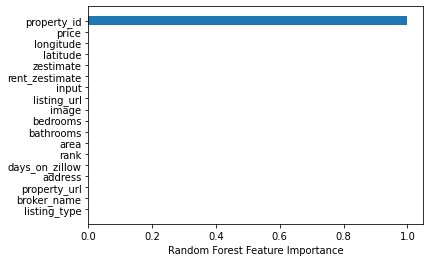

In [27]:
# To have an even better chart, let’s sort the features, and plot again:
sorted_idx = rf.feature_importances_.argsort()
plt.barh(re_data.columns[sorted_idx], rf.feature_importances_[sorted_idx])
plt.xlabel("Random Forest Feature Importance")

### 3.2 Feature Importance PCA # Jocelyn

In [28]:
pca = PCA(n_components=1) # n_components == min(n_samples, n_features)
pca.fit(re_data)

PCA(copy=True, iterated_power='auto', n_components=1, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [29]:
print(pca.components_)

[[ 1.15084497e-08  9.99999986e-01 -9.85543800e-08 -3.62318759e-10
  -6.35031988e-10  1.48533380e-04  1.05047730e-10 -1.30460141e-10
   5.57943334e-08  7.35836333e-05 -2.08654516e-07  5.53285746e-09
   1.02580988e-08 -3.80945415e-10  1.83465038e-08 -2.00556946e-10
  -7.41774350e-08 -2.27524183e-09]]


In [30]:
# explained_variance_: ndarray of shape (n_components,)
# The amount of variance explained by each of the selected components.
# Equal to n_components largest eigenvalues of the covariance matrix of X.
print(pca.explained_variance_)

[9.83062384e+16]


In [31]:
# explained_variance_ratio_: ndarray of shape (n_components,)
# Percentage of variance explained by each of the selected components.
# If n_components is not set then all components are stored and the sum of the ratios is equal to 1.0
print(pca.explained_variance_ratio_)

[0.99996441]


Text(0.5, 1.0, 'The number of components needed to explain variance')

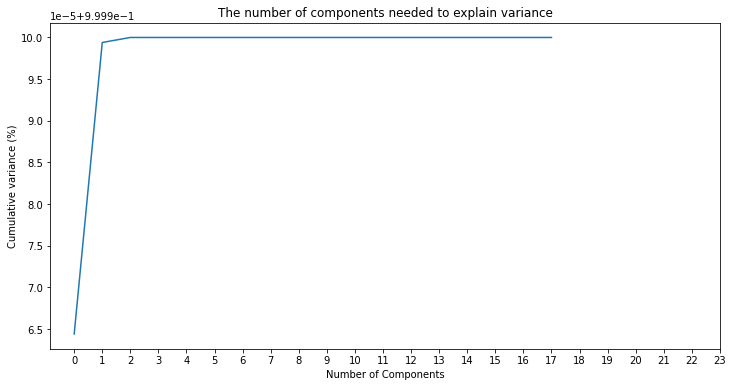

In [32]:
plt.rcParams["figure.figsize"] = (12,6)
pca = PCA().fit(re_data)

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.xticks(np.arange(0, 24, step=1)) #change from 0-based array index to 1-based human-readable label
plt.ylabel('Cumulative variance (%)')
plt.title('The number of components needed to explain variance')

### 4. Implement 3 amalgamations:
1.	first data set # Jocelyn
2.	second data enrichment -- get an amalgamation; each enrichment enables you to implement / use more algorithms as needed. # Bhuvana
3.	Third data enrichment -- scrape data from a source and amalgamate # Weifeng

### 4.1 Yearly Amalgamated House ( sale and list price ) # Jocelyn

Data Narrative : Get the monthly current list and sale price in Zillow website then combine the given 2021 listed price to monthly average price ( 2018 ~ 2020)

In [64]:
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/Metro_mlp_uc_sfrcondo_smoothed_month_listprice.csv'

amal_data1 = pd.read_csv(path)

In [65]:
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/Metro_mlp_uc_sfrcondo_smoothed_month_salesprice.csv'

amal_data2 = pd.read_csv(path)

Data cleaning and Creation

In [66]:
amal_data1.head(2)

,RegionID,SizeRank,RegionName,RegionType,StateName,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28
0,102001,0,United States,Country,NaN,271600.0,272967.0,279333.0,288667.0,295633.0,299267.0,299833.0,299533.0,298900.0,298167.0,296800.0,294100.0,291567.0,292933.0,297967.0,306333.0,314000.0,320333.0,321967.0,319633.0,314967.0,311633.0,306633.0,303233.0,299600.0,301263.0,306330.0,312891.0,320228.0,327728.0,334833.0,339833.0,342000.0,342967.0,341967.0,337300.0,332983.0,333317.0
1,394913,1,"New York, NY",Msa,NY,520967.0,525967.0,535967.0,547667.0,557667.0,564333.0,565667.0,559300.0,552967.0,552967.0,553000.0,552667.0,549333.0,549333.0,556000.0,566000.0,576145.0,579812.0,578479.0,574967.0,573300.0,574633.0,577667.0,579000.0,577667.0,579667.0,586333.0,594333.0,599000.0,602667.0,612967.0,629596.0,642596.0,649296.0,649667.0,650000.0,650000.0,650000.0


In [67]:
amal_data2.head(2)

,RegionID,SizeRank,RegionName,RegionType,StateName,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28
0,102001,0,United States,Country,NaN,271600.0,272967.0,279333.0,288667.0,295633.0,299267.0,299833.0,299533.0,298900.0,298167.0,296800.0,294100.0,291567.0,292933.0,297967.0,306333.0,314000.0,320333.0,321967.0,319633.0,314967.0,311633.0,306633.0,303233.0,299600.0,301263.0,306330.0,312891.0,320228.0,327728.0,334833.0,339833.0,342000.0,342967.0,341967.0,337300.0,332983.0,333317.0
1,394913,1,"New York, NY",Msa,NY,520967.0,525967.0,535967.0,547667.0,557667.0,564333.0,565667.0,559300.0,552967.0,552967.0,553000.0,552667.0,549333.0,549333.0,556000.0,566000.0,576145.0,579812.0,578479.0,574967.0,573300.0,574633.0,577667.0,579000.0,577667.0,579667.0,586333.0,594333.0,599000.0,602667.0,612967.0,629596.0,642596.0,649296.0,649667.0,650000.0,650000.0,650000.0


In [68]:
amal_data1 = amal_data1.drop(columns=['RegionID','RegionType','StateName', 'SizeRank'])

In [69]:
amal_data2 = amal_data2.drop(columns=['RegionID','RegionType','StateName', 'SizeRank'])

In [70]:
amal_data1 = amal_data1.transpose()

In [71]:
amal_data2 = amal_data2.transpose()

In [ ]:
#amal_data1

In [ ]:
#amal_data2

In [75]:
# Save data
path = '/content/drive/My Drive/data/Data_created/house_cleaned_list_price_data.csv'

amal_data1.to_csv(path, index=False)

In [76]:
# Save data
path = '/content/drive/My Drive/data/Data_created/house_cleaned_sales_price_data.csv'

amal_data2.to_csv(path, index=False)

Combine the data the 2021 listed price


In [77]:
path = '/content/drive/My Drive/data/Data_created/PriceSales_data/house_cleaned_list_price2018_2021_data.csv'

redata_listedprice2018_2021 = pd.read_csv(path)

In [78]:
path = '/content/drive/My Drive/data/Data_created/PriceSales_data/house_cleaned_sale_price2018_2021_data.csv'

redata_saleprice2018_2021 = pd.read_csv(path)

In [79]:
redata_listedprice2018_2021

,date,address,price
0,2018,United States,309717
1,2018,"New York, NY",581516
2,2018,"Los Angeles-Long Beach-Anaheim, CA",854321
3,2018,"Chicago, IL",854321
4,2018,"Dallas-Fort Worth, TX",329096
...,...,...,...
1030,2021,"2803 S Decatur St, Denver, CO 80236",389000
1031,2021,"629 Elati St, Denver, CO 80204",650000
1032,2021,"87 S Washington St #101, Denver, CO 80209",469900
1033,2021,"4718 Winona Ave, San Diego, CA 92115",710000


In [80]:
redata_saleprice2018_2021

,date,address,price
0,2018,United States,318260
1,2018,"New York, NY",321887
2,2018,"Los Angeles-Long Beach-Anaheim, CA",328918
3,2018,"Chicago, IL",337342
4,2018,"Dallas-Fort Worth, TX",343636
5,2018,"Philadelphia, PA",346655
6,2018,"Houston, TX",345613
7,2018,"Washington, DC",341411
8,2018,"Miami-Fort Lauderdale, FL",337905
9,2018,"Atlanta, GA",333718


In [81]:
redata_listedprice2018_2021 = redata_listedprice2018_2021.rename(columns={'price': 'listed_price'})

In [82]:
redata_saleprice2018_2021 = redata_saleprice2018_2021.rename(columns={'price': 'sale_price'})

In [102]:
redata_listedprice2018_2021.head(2)

,date,address,listed_price
0,2018,United States,309717
1,2018,"New York, NY",581516


In [103]:
redata_saleprice2018_2021.head(2)

,date,address,sale_price
0,2018,United States,318260
1,2018,"New York, NY",321887


Merge the Sale and List Price

In [179]:
# redata_listedprice2018_2021.merge(redata_saleprice2018_2021, left_on='LPrice', right_on='SPrice')
frames = [redata_listedprice2018_2021, redata_saleprice2018_2021]

merge_data = pd.concat(frames)

In [180]:
merge_data.head(2)

,date,address,listed_price,sale_price
0,2018,United States,309717.0,NaN
1,2018,"New York, NY",581516.0,NaN


In [181]:
merge_data.isnull().sum()/merge_data.shape[0] * 100

date             0.000000
address          0.000000
listed_price     3.541473
sale_price      96.458527
dtype: float64

In [182]:
merge_data.head(10)

,date,address,listed_price,sale_price
0,2018,United States,309717.0,NaN
1,2018,"New York, NY",581516.0,NaN
2,2018,"Los Angeles-Long Beach-Anaheim, CA",854321.0,NaN
3,2018,"Chicago, IL",854321.0,NaN
4,2018,"Dallas-Fort Worth, TX",329096.0,NaN
5,2018,"Philadelphia, PA",348220.0,NaN
6,2018,"Houston, TX",287495.0,NaN
7,2018,"Washington, DC",318882.0,NaN
8,2018,"Miami-Fort Lauderdale, FL",488851.0,NaN
9,2018,"Atlanta, GA",287495.0,NaN


In [183]:
# Rows
merge_data = merge_data.dropna(subset=['listed_price'] )

In [184]:
merge_data.isnull().sum()/merge_data.shape[0] * 100

date              0.0
address           0.0
listed_price      0.0
sale_price      100.0
dtype: float64

In [185]:
# Save data
path = '/content/drive/My Drive/data/Data_created/merge_price_data.csv'

merge_data.to_csv(path, index=False)

### 4.1.1 Distribution

In [156]:
import plotly.express as px
fig = px.histogram(redata_listedprice2018_2021, x="date", y="listed_price", color="date",histfunc='avg', title="Average Yearly Listed Housing Price")
fig.show()

In [92]:
import plotly.express as px
fig = px.histogram(redata_saleprice2018_2021, x="date", y="sale_price", color="date",histfunc='avg', title="Average Yearly Sale Housing Price")
fig.show()

### 5. Implement ml algorithms to build models and refine your data narrative
1.	Define a Golden cluster and use Fractal Clustering to find it based on the business case you formulate # Jocelyn

2.	train and Apply algorithms : you can use the muller loop
    1.	classify: Muller, at least 5 algos # Jocelyn
    2.	Regression: Muller, at least 7 algos # Jocelyn
3.	Compare relevant tasks in the same table.
    1.	Write a data narrative to interpret results of each algorithm # Bhuvana, Weifeng, Jocelyn



### 5.1 Golden Cluster

Data Narrative :

During Second Fractal Clustering of Cluster2_1, found the three Golden Clusters 0, 1, 2 with each mean value of price and zillow rent estimates. 

Segmentation was based on House Listing Type with average price and rent estimate value. Clearly there is an increase of rent estimate per house price basis.

Base on visualization of golden cluster all listing type of houses were directly proportional to the house price and rent increase. It means investments on realty field is always a profit gain.




In [12]:
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/house_cleaned_data_class.csv'

re_data = pd.read_csv(path)

In [15]:
re_data.head(1)

,rank,property_id,address,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,image,listing_type,broker_name,input,property_url,listing_url
0,42,17137939,"6121 Parkside Ave, San Diego, CA 92139",32.665719,-117.054594,619000.0,3.0,4.0,1844.0 sqft,640674.0,3100.0,1,https://photos.zillowstatic.com/fp/316da0f2c56...,House for sale,RE/MAX Clarity,"https://www.zillow.com/homes/San-Diego,-CA_rb/",https://www.zillow.com/homedetails/6121-Parksi...,"https://www.zillow.com/homes/San-Diego,-CA_rb/..."


In [5]:
x1 = re_data.iloc[:, [5]] # price
x2 = re_data.iloc[:, [10]] # rent_estimate

In [16]:
X = re_data.iloc[:, [5, 10]].values

### 5.1.1 First KMeans Clustering Iteration

In [33]:
def plot_cluster(n, max_loop=50):
    """
    Looking at the performance of various number of clusters using K-Means.
    Performance is evaluated by within cluster SSE and silhouette score.
    """

    X = re_data.iloc[:, [5, 10]].values
    # Using Standard Scaler
    sc = StandardScaler()
    S_c = sc.fit_transform(X)
    sse_within_cluster = {}
    silhouette_score = {}
    
    for k in range(2, max_loop):
        kmeans = KMeans(n_clusters=k,  random_state=10, n_init=10, n_jobs=-1)
        kmeans.fit(S_c)
        sse_within_cluster[k] = kmeans.inertia_
        silhouette_score[k] = metrics.silhouette_score(S_c, kmeans.labels_, random_state=10)
    
    _ = plt.figure(figsize=(10,6))
    ax1 = plt.subplot(211)
    _ = plt.plot(list(sse_within_cluster.keys()), list(sse_within_cluster.values()))
    _ = plt.xlabel("Number of Clusters")
    _ = plt.ylabel("SSE Within Cluster")
    _ = plt.title("Within Cluster SSE K-Means Clustering")
    _ = plt.xticks([i for i in range(2, max_loop)], rotation=75)
    
    ax2 = plt.subplot(212)
    _ = plt.plot(list(silhouette_score.keys()), list(silhouette_score.values()))
    _ = plt.xlabel("Number of Clusters")
    _ = plt.ylabel("Silhouette Score")
    _ = plt.title("Silhouette Score K-Means Clustering")
    _ = plt.xticks([i for i in range(2, max_loop)], rotation=75)
    
    plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5, wspace=0.35)

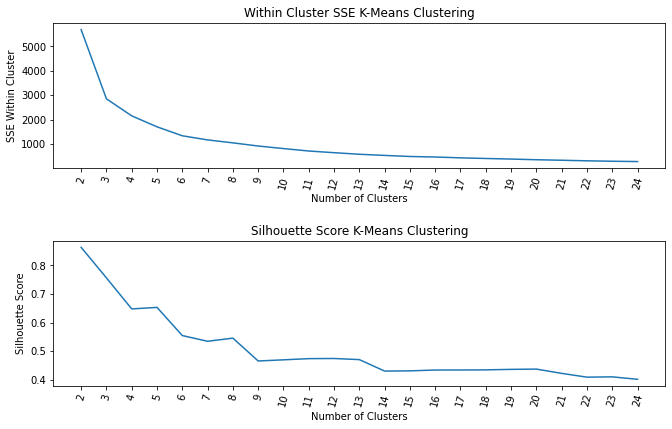

In [34]:
plot_cluster(X, max_loop=25)

In [41]:
# Applying Silhouette Score
def apply_cluster(n, clusters=2):
    """
    Applying K-Means with the optimal number of clusters identified
    """

    X = re_data.iloc[:, [5, 10]].values
    # Standard Scaler
    sc = StandardScaler()
    S_c = sc.fit_transform(X)

    kmeans = KMeans(n_clusters = clusters, init = 'k-means++', random_state = 42) 
    y_kmeans = kmeans.fit_predict(S_c)
    score = metrics.silhouette_score(S_c, kmeans.labels_, random_state=10)
    # df['cluster'] = kmeans.labels_
    sse_within_cluster = kmeans.inertia_
    
    print("clustering performance")
    print("-----------------------------------")
    print("silhouette score1: " + str(score.round(2)))
    print("sse withing cluster1: " + str(sse_within_cluster.round()))
    
    return n

In [42]:
# Using clusters = 3
first_trial = apply_cluster(X, clusters=3)

clustering performance
-----------------------------------
silhouette score1: 0.76
sse withing cluster1: 2848.0


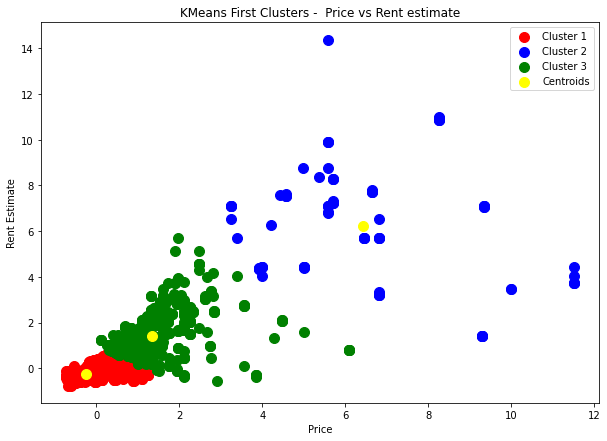

In [72]:
# Performing Kmeans using Clusters = 3
from sklearn.preprocessing import StandardScaler
X = re_data.iloc[:, [5, 10]].values
# Standard Scaler
sc = StandardScaler()
S_c = sc.fit_transform(X)

kmeans = KMeans(n_clusters = 3, init = 'k-means++', random_state = 42)
y_kmeans = kmeans.fit_predict(S_c)

plt.figure(figsize=(10,7))
plt.scatter(S_c[y_kmeans == 0, 0], S_c[y_kmeans == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(S_c[y_kmeans == 1, 0], S_c[y_kmeans == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(S_c[y_kmeans == 2, 0], S_c[y_kmeans == 2, 1], s = 100, c = 'green', label = 'Cluster 3')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 100, c = 'yellow', label = 'Centroids')
plt.title('KMeans First Clusters -  Price vs Rent estimate')
plt.xlabel('Price')
plt.ylabel('Rent Estimate')
# plt.xticks([i for i in range(0, 10)], rotation=360)
# plt.yticks([i for i in range(0, 10)], rotation=360)
plt.legend()
plt.show()

### 5.1.2 First Fractal Clustering

In [52]:
Cluster1 = re_data[['price','rent_zestimate', 'address', 'listing_type']] 

In [54]:
new = re_data._get_numeric_data().dropna(axis=1)
Cluster1['cluster_1'] = pd.Series(y_kmeans, index=re_data.index)

In [59]:
cluster1_performance = (Cluster1.groupby('cluster_1')
    .agg({"price":'mean',"rent_zestimate":"mean", "address":"count", "listing_type":"count"})
    .sort_values('listing_type')
    .reset_index())

cluster1_performance

,cluster_1,price,rent_zestimate,address,listing_type
0,1,9.955593e+06,25881.767442,86,86
1,2,2.921138e+06,8711.447522,686,686
2,0,7.019818e+05,2744.656115,5781,5781


In [60]:
# creating a dataframe that only consists of cluster `0` with highest count cluster
cluster1_1 = Cluster1.query("cluster_1 == 0").reset_index(drop=True)
cluster1_1 = cluster1_1.drop('cluster_1',axis = 1)
cluster1_1

,price,rent_zestimate,address,listing_type
0,619000.0,3100.0,"6121 Parkside Ave, San Diego, CA 92139",House for sale
1,339900.0,2100.0,"9234 E Lehigh Ave, Denver, CO 80237",Under Contract
2,340000.0,1565.0,"925 N Lincoln St UNIT 12J-S, Denver, CO 80203",Under Contract
3,250000.0,2800.0,"4345 N Elizabeth St, Denver, CO 80216",Multi-family home for sale
4,790000.0,2800.0,"3616 Lowell Blvd, Denver, CO 80211",House for sale
...,...,...,...,...
5776,699000.0,2500.0,"3157 S Evelyn Way, Denver, CO 80222",Under Contract
5777,249000.0,1595.0,"495 San Pasqual Valley Rd UNIT 124, Escondido,...",Condo for sale
5778,1750000.0,4940.0,"3119 Quiet Hills Pl, Escondido, CA 92029",House for sale
5779,447800.0,2100.0,"525 11th Ave UNIT 1206, San Diego, CA 92101",Condo for sale


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f4e4c4ff3d0>,
      dtype=object)

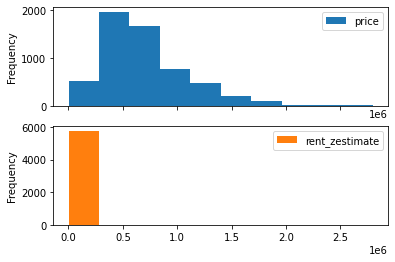

In [62]:
cluster1_1[["price", "rent_zestimate"]].plot(bins=10, kind="hist", subplots=True)

### 5.1.3 Second KMeans Clustering Iteration

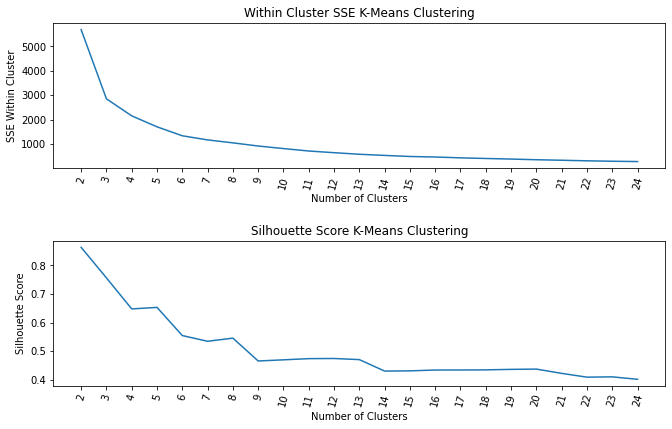

In [79]:
## Performed SSE and Silhouette Score on Three Clusters
plot_cluster(cluster1_1[["price", "rent_zestimate"]], max_loop=25)

In [80]:
# Applying Silhouette Score
def apply_cluster(n, clusters=2):
    """
    Applying K-Means with the optimal number of clusters identified
    """

    X = re_data.iloc[:, [5, 10]].values
    # Standard Scaler
    sc = StandardScaler()
    S_c = sc.fit_transform(X)

    kmeans = KMeans(n_clusters = clusters, init = 'k-means++', random_state = 42) 
    y_kmeans = kmeans.fit_predict(S_c)
    score = metrics.silhouette_score(S_c, kmeans.labels_, random_state=10)
    # df['cluster'] = kmeans.labels_
    sse_within_cluster = kmeans.inertia_
    
    print("clustering performance")
    print("-----------------------------------")
    print("silhouette score2: " + str(score.round(2)))
    print("sse withing cluster2: " + str(sse_within_cluster.round()))
    
    return n

In [81]:
# Using clusters = 3
second_trial = apply_cluster(cluster1_1[["price", "rent_zestimate"]], clusters=3)

clustering performance
-----------------------------------
silhouette score2: 0.76
sse withing cluster2: 2848.0


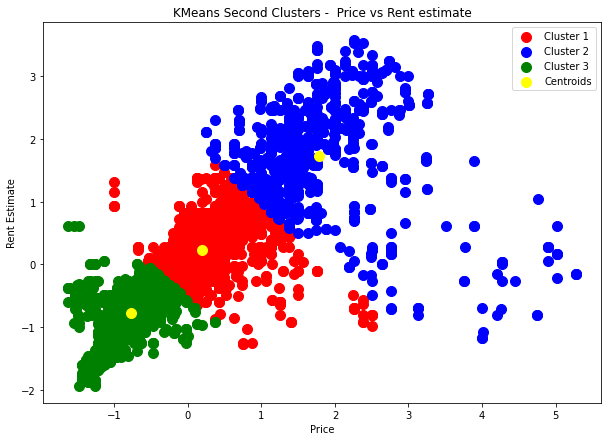

In [82]:
# Performing Second Kmeans using Clusters = 3
# Standard Scaler
sc = StandardScaler()
S_c = sc.fit_transform(cluster1_1[["price", "rent_zestimate"]])

kmeans = KMeans(n_clusters = 3, init = 'k-means++', random_state = 42)
y_kmeans_5 = kmeans.fit_predict(S_c)

plt.figure(figsize=(10,7))
plt.scatter(S_c[y_kmeans_5 == 0, 0], S_c[y_kmeans_5 == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(S_c[y_kmeans_5 == 1, 0], S_c[y_kmeans_5 == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(S_c[y_kmeans_5 == 2, 0], S_c[y_kmeans_5 == 2, 1], s = 100, c = 'green', label = 'Cluster 3')

plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 100, c = 'yellow', label = 'Centroids')
plt.title('KMeans Second Clusters -  Price vs Rent estimate')
plt.xlabel('Price')
plt.ylabel('Rent Estimate')
# plt.xticks([i for i in range(0, 10)], rotation=360)
# plt.yticks([i for i in range(0, 10)], rotation=360)
plt.legend()
plt.show()

### 5.1.4 Second Fractal Clustering

In [76]:
Cluster2 = re_data[['price','rent_zestimate', 'address', 'listing_type']] 

In [77]:
new = re_data._get_numeric_data().dropna(axis=1)
Cluster2['cluster_2'] = pd.Series(y_kmeans, index=re_data.index)

In [78]:
cluster2_performance = (Cluster2.groupby('cluster_2')
    .agg({"price":'mean',"rent_zestimate":"mean", "address":"count", "listing_type":"count"})
    .sort_values('listing_type')
    .reset_index())

cluster2_performance

,cluster_2,price,rent_zestimate,address,listing_type
0,1,9.955593e+06,25881.767442,86,86
1,2,2.921138e+06,8711.447522,686,686
2,0,7.019818e+05,2744.656115,5781,5781


In [83]:
# creating a dataframe that only consists of cluster `0` with highest count cluster
cluster2_1 = Cluster2.query("cluster_2 == 0").reset_index(drop=True)
cluster2_1 = cluster2_1.drop('cluster_2',axis = 1)
cluster2_1

,price,rent_zestimate,address,listing_type
0,619000.0,3100.0,"6121 Parkside Ave, San Diego, CA 92139",House for sale
1,339900.0,2100.0,"9234 E Lehigh Ave, Denver, CO 80237",Under Contract
2,340000.0,1565.0,"925 N Lincoln St UNIT 12J-S, Denver, CO 80203",Under Contract
3,250000.0,2800.0,"4345 N Elizabeth St, Denver, CO 80216",Multi-family home for sale
4,790000.0,2800.0,"3616 Lowell Blvd, Denver, CO 80211",House for sale
...,...,...,...,...
5776,699000.0,2500.0,"3157 S Evelyn Way, Denver, CO 80222",Under Contract
5777,249000.0,1595.0,"495 San Pasqual Valley Rd UNIT 124, Escondido,...",Condo for sale
5778,1750000.0,4940.0,"3119 Quiet Hills Pl, Escondido, CA 92029",House for sale
5779,447800.0,2100.0,"525 11th Ave UNIT 1206, San Diego, CA 92101",Condo for sale


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f4e4d38e0d0>,
      dtype=object)

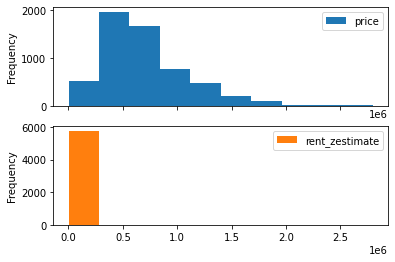

In [84]:
cluster2_1[["price", "rent_zestimate"]].plot(bins=10, kind="hist", subplots=True)

### 5.1.5 Visualization of Clustered Data

Data Narrative:

All listing type of houses were directly proportional to the house price and rent increase. It means investment on realty is always a profit gain. 

Lowest Price : House For Sale (250k ~ 2.8M)

Second Price : MultiFamily Home For Sale (150k ~ 1.75M)

Third Price : Condo (100k ~ 2.6M)

Fourth Price : Home For Sale (50k ~ 550k)

Fifth Price : Foreclosure (645k ~ 1.7M)

In [152]:
import plotly.express as px
fig = px.histogram(cluster2_1, x="price", y="rent_zestimate", color="listing_type", histfunc='avg',hover_data=cluster2_1.columns, title='Segmentation of House Listing Type per Price vs Average Rent Estimate')
fig.show()

### 5.2 Classification

Data Narrative :

Classification model with high accuracy is Neareast Neighbors with 16.37% and with F1-score 0.16. F1-score measures the correct prediction of true value based on its precision and recall value. It means that the model does not have good capability of predicting the true value of price and rent estimate.

Confusion Matrix is not visible if plotted because and took time to run it. I just added the array results of Confusion Matrix.

In [147]:
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/house_cleaned_data_class.csv'

re_data = pd.read_csv(path)

In [148]:
# Load the data selected for Regression
X_class = re_data[['price']] 
y_class = re_data[['rent_zestimate']]

In [149]:
# Train the dataset
X_train, X_test, y_train, y_test = train_test_split(X_class, y_class, test_size=0.30)

#second error need to convert column vector y to an 1D array as expected for training one feature
y_train = y_train.values.ravel()
y_train[:10]

names = ["Nearest Neighbors", "Decision Tree", "Random Forest", "Neural Net", "AdaBoost"]

In [150]:
classifiers = [
    KNeighborsClassifier(2),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, solver='adam', max_iter=500),
    AdaBoostClassifier(),
    ]
class_output = pd.DataFrame(columns=['classifier', 'F1 score', 'accuracy', 'Training time'])

In [151]:
max_score = 0.0
max_class = ''
# iterate over classifiers

for name, clf in zip(names, classifiers):
    start_time = time.process_time()
    time_finish = time.process_time() - start_time
    clf.fit(X_train, y_train)
    score = 100.0 * clf.score(X_test, y_test)
    y_preds = clf.predict(X_test)
  
    f1 = np.round(metrics.f1_score(y_test, y_preds, average='weighted'), 2)
    # f1 = np.round(metrics.f1_score(y_test, y_predict), 2)
    class_output = class_output.append({'classifier': name, 'F1 score':f1, 'accuracy':score, 'Training time':time_finish}, ignore_index=True)
   
    print('Classifier = %s, Score (test, accuracy) = %.2f' %(name, score))
    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score),'Training time = %.2f seconds,'%(time.process_time() - start_time))

Classifier = Nearest Neighbors, Score (test, accuracy) = 16.33
Classifier = Decision Tree, Score (test, accuracy) = 7.53
Classifier = Random Forest, Score (test, accuracy) = 8.85


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.



Classifier = Neural Net, Score (test, accuracy) = 3.87
Classifier = AdaBoost, Score (test, accuracy) = 4.12
--------------------------------------------------------------------------------
Best --> Classifier = Nearest Neighbors, Score (test, accuracy) = 16.33 Training time = 16.09 seconds,


In [146]:
import pickle 
filename = 'JBfinal_classification_model.sav'
pickle.dump(clf_best, open(filename, 'wb'))
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
# Load the saved model and evaluating it provides an estimate of accuracy of the model on test data.
result = loaded_model.score(X_test, y_test)
print(result)

0.9188462409175979


In [110]:
display(class_output)

,classifier,F1 score,accuracy,Training time
0,Nearest Neighbors,0.15,16.378433,0.000005
1,Decision Tree,0.04,8.596134,0.000004
2,Random Forest,0.05,9.308240,0.000003
3,Neural Net,0.00,3.357070,0.000004
4,AdaBoost,0.00,4.272635,0.000006


Confusion Matrix

In [111]:
X_train, X_test, y_train, y_test = train_test_split(X_class, y_class, test_size=0.30, random_state=42)

In [112]:
clf1 = KNeighborsClassifier(2)
clf1.fit(X_train, y_train)
y_preds = clf1.predict(X_test)
y_proba = clf1.predict_proba(X_test)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [113]:
def get_confusion_matrix(y_true, y_pred):
    n_classes = len(np.unique(y_true))
    conf = np.zeros((n_classes, n_classes))
    for actual, pred in zip(y_true, y_pred):
        conf[int(actual)][int(pred)] += 1
    return conf.astype('int')

In [114]:
conf = metrics.confusion_matrix(y_test, y_preds)
conf

array([[0, 1, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
# It takes time to plot it because of five models classifier
plot_confusion_matrix(clf1, X_test, y_test)

In [115]:
clf2 = DecisionTreeClassifier(max_depth=5)
clf2.fit(X_train, y_train)
y_preds = clf2.predict(X_test)
y_proba = clf2.predict_proba(X_test)

In [116]:
conf = metrics.confusion_matrix(y_test, y_preds)
conf

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [117]:
# Predict some sample
y_proba[:5], y_preds[:5], y_test[:5]
conf = metrics.confusion_matrix(y_test, y_preds)

In [118]:
y_proba

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.00943396, ..., 0.        , 0.        ,
        0.        ]])

In [120]:
y_preds

array([2250., 2000., 2200., ..., 3200., 2000., 1050.])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



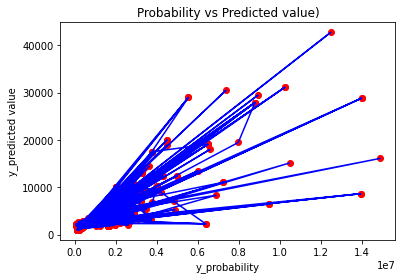

In [136]:
clf1 = KNeighborsClassifier(2)
clf1.fit(X_train, y_train)
y_preds = clf1.predict(X_test)
y_proba = clf1.predict_proba(X_test)

plt.scatter(X_test, y_preds, color = 'red')
plt.plot(X_test, clf1.predict(X_test), color = 'blue')
plt.title('Probability vs Predicted value)')
plt.xlabel('y_probability')
plt.ylabel('y_predicted value')
plt.show()

### 5.3 Regression


Data Narrative :

Best Model for Regression is Neareast Neighbors with 90.14% Accuracy. It has a MAE value(474.42), MSE value(1174314.35). 

I think this real estate problem is fit only for Regression Model because it has a higher accuracy prediction. 


In [137]:
path = '/content/drive/My Drive/Underdog/midterm_exam/data/Data_created/house_cleaned_data_reg.csv'

re_data = pd.read_csv(path)

In [138]:
re_data.head(2)

,rank,property_id,address,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,image,listing_type,broker_name,input,property_url,listing_url
0,42,17137939,"6121 Parkside Ave, San Diego, CA 92139",32.665719,-117.054594,619000.0,3.0,4.0,1844.0 sqft,640674.0,3100.0,1,https://photos.zillowstatic.com/fp/316da0f2c56...,House for sale,RE/MAX Clarity,"https://www.zillow.com/homes/San-Diego,-CA_rb/",https://www.zillow.com/homedetails/6121-Parksi...,"https://www.zillow.com/homes/San-Diego,-CA_rb/..."
1,773,13421124,"9234 E Lehigh Ave, Denver, CO 80237",39.646839,-104.882522,339900.0,3.0,3.0,1408.0 sqft,348728.0,2100.0,22,https://photos.zillowstatic.com/fp/49edd313f7e...,Under Contract,Blackwell Real Estate LLC,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/homedetails/9234-E-Lehi...,"https://www.zillow.com/homes/denver,-co_rb/20_p/"


In [139]:
# Load the data selected for Regression
X_reg = re_data[['price']] 
y_reg = re_data[['rent_zestimate']]

In [140]:
# Train the dataset
X_train, X_test, y_train, y_test = train_test_split(X_reg, y_reg, test_size=0.30)
y_train = y_train.values.ravel()
names = ["Nearest Neighbors", "Linear SVR", "Gaussian Process",
         "Decision Tree", "Random Forest", "MLP", "AdaBoost"
         ]

In [141]:
regression = [
    KNeighborsRegressor(2),
    SVR(kernel='rbf', degree=3, gamma='scale', coef0=0.0, tol=0.001, C=1.0, epsilon=0.1, shrinking=True, cache_size=200, verbose=False, max_iter=- 1),
    GaussianProcessRegressor(kernel=None, alpha=1e-10, optimizer='fmin_l_bfgs_b', n_restarts_optimizer=0, normalize_y=False, copy_X_train=True, random_state=None),
    DecisionTreeRegressor(criterion='mse', splitter='best', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features=None, random_state=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_impurity_split=None, ccp_alpha=0.0),
    RandomForestRegressor(max_depth=5, n_estimators=10, max_features=1),
    MLPRegressor(alpha=1, max_iter=1500),
    AdaBoostRegressor(base_estimator=None, n_estimators=50, learning_rate=1.0, loss='linear', random_state=None)
    ]
reg_output = pd.DataFrame(columns=['regressor','mae', 'mse', 'Rsquared', 'accuracy', 'Training time'])

In [142]:
max_score = 0.0
max_class = ''
# iterate over regressor
for name, clf in zip(names, regression):
    start_time = time.process_time()
    time_finish = time.process_time() - start_time
    clf.fit(X_train, y_train)
  
    score = 100.0 * clf.score(X_test, y_test)
    y_predict = clf.predict(X_test)

    
    mae = np.round(metrics.mean_absolute_error(y_test, y_predict), 2)
    mse = np.round(metrics.mean_squared_error(y_test, y_predict), 2)
    rsquared = np.round(metrics.r2_score(y_test, y_predict), 2)
    reg_output = reg_output.append({'regressor': name, 'mae':mae, 'mse':mse,'Rsquared':rsquared, 'accuracy':score, 'Training time':time_finish}, ignore_index=True)

    # print("MSE : " , np.round(metrics.mean_squared_error(y_test, y_pred), 2))
    # print("MAE : " , np.round(metrics.mean_absolute_error(y_test, y_pred), 2))
    # print("RSquared : " , np.round(metrics.r2_score(y_test, y_pred), 2))
    # print('Regression = %s, Score (accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds,'%(time.process_time() - start_time))
    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name
print(80*'-' )
print('Best --> Regression = %s, Score (accuracy) = %.2f' %(max_class, max_score),'Training time = %.2f seconds,'%(time.process_time() - start_time))

--------------------------------------------------------------------------------
Best --> Regression = Decision Tree, Score (accuracy) = 91.88 Training time = 0.23 seconds,


In [145]:
# Save the pickle file
import pickle 
filename = 'JBfinal_regression_model.sav'
pickle.dump(clf_best, open(filename, 'wb'))
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
# Load the saved model and evaluating it provides an estimate of accuracy of the model on test data.
result = loaded_model.score(X_test, y_test)
print(result)

0.9188462409175979


In [144]:
display(reg_output)

,regressor,mae,mse,Rsquared,accuracy,Training time
0,Nearest Neighbors,502.87,1597721.47,0.91,90.756612,0.000007
1,Linear SVR,1412.51,16788839.46,0.03,2.870583,0.000007
2,Gaussian Process,536.36,2512754.17,0.85,85.462822,0.000008
3,Decision Tree,442.13,1402744.37,0.92,91.884624,0.000010
4,Random Forest,618.65,2285299.65,0.87,86.778727,0.000010
5,MLP,1465.87,7056446.33,0.59,59.175944,0.000011
6,AdaBoost,846.33,3311113.69,0.81,80.844028,0.000010


### 6.	Suggest Latent Variables or Latent Manifolds, add then to the features and see how prediction results change # Weifeng


### 6.1 Prediction Latent Variable Date, Listed and Sale Price # Jocelyn

How to use the interactive graph : Click the top hover compared on the top right near icon of Ploty. Then hover the data in the graph you can see the predicted listed price based on the trend compared to the current listed price. I used the date, listed and sale price as my latent variable to complete the objective of prediction of average house price.

Data Narrative: 

There is an increase of average listing price based on the prediction trend of house prices per year basis. 

Using sklearn Linear Fit Regression function the result of prediction and the graph are both the same.

In [178]:
# Year date vs Listed Price Prediction
import plotly.express as px
fig = px.scatter(merge_data, x="date", y="listed_price", trendline='ols',  title='Year date vs Listed Price Prediction')
fig.show()

### 6.1.1 Prediction Using SkLearn


In [186]:
import numpy as np
from sklearn.linear_model import LinearRegression
X = merge_data.iloc[:, 0].values
y = merge_data.iloc[:, 2].values

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 1/3, random_state = 0)

# Reshape data
y_train = y_train.reshape(-1,1)
X_train = X_train.reshape(-1,1)
X_test = X_test.reshape(-1,1)
y_test = y_test.reshape(-1,1)

regressor = LinearRegression()
regressor.fit(X_train, y_train)


y_pred = regressor.predict(X_test)

In [ ]:
y_pred

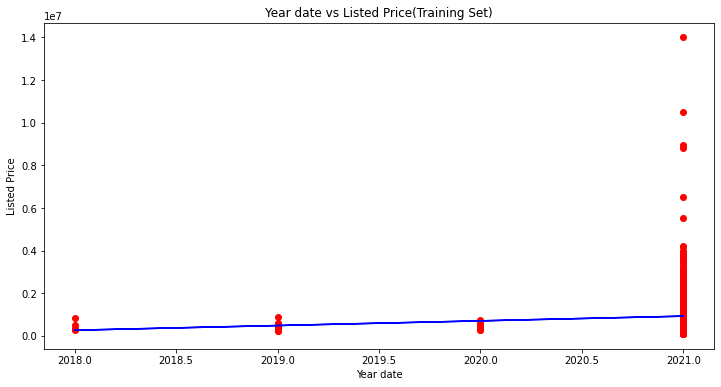

In [188]:
plt.scatter(X_train, y_train, color = 'red')
plt.plot(X_train, regressor.predict(X_train), color = 'blue')
plt.title('Year date vs Listed Price(Training Set)')
plt.xlabel('Year date')
plt.ylabel('Listed Price')
plt.show()

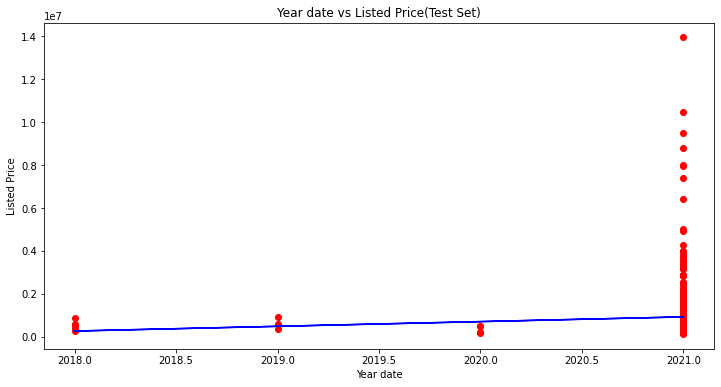

In [189]:
plt.scatter(X_test, y_test, color = 'red')
plt.plot(X_train, regressor.predict(X_train), color = 'blue')
plt.title('Year date vs Listed Price(Test Set)')
plt.xlabel('Year date')
plt.ylabel('Listed Price')
plt.show()

### 7.	use appropriate metrics for measuring models and compare them in a table: regression metrics and/or classification metrics (confusion matrix, f1) # Weifeng, Jocelyn




Comparison Metrics Score:

Data Narrative: 

Regression : Highest Accury - Decision Tree 90.14%.

Classification : Nearest Neighbors - F1 score 0.16, 16.78% accuracy

In [ ]:
display(reg_output, class_output)

,regressor,mae,mse,Rsquared,accuracy,Training time
0,Nearest Neighbors,474.42,1174314.35,0.90,89.564188,0.000005
1,Linear SVR,1256.25,10587166.42,0.06,5.914734,0.000006
2,Gaussian Process,510.58,1854242.80,0.84,83.521849,0.000007
3,Decision Tree,430.44,1108647.94,0.90,90.147748,0.000010
4,Random Forest,586.45,1892260.02,0.83,83.184000,0.000010
5,MLP,1827.29,6130765.15,0.46,45.517559,0.000009
6,AdaBoost,812.66,2787818.59,0.75,75.225415,0.000009


,classifier,F1 score,accuracy,Training time
0,Nearest Neighbors,0.16,16.785351,0.000008
1,Decision Tree,0.04,7.833164,0.000005
2,Random Forest,0.06,9.715158,0.000005
3,Neural Net,0.00,3.306205,0.000004
4,AdaBoost,0.01,4.425229,0.000007
